<a href="https://colab.research.google.com/github/LIONHOOD/ExplainableAI/blob/main/XAI_LIME_%2B_SHAP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CNN의 해석 예시

## 라이브러리 / 데이터 / pretrained 모델

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

from torch.utils.data import  DataLoader
from torchvision import models
import torchsummary

import torchvision.transforms as transforms
import torchvision.datasets as dataset

import matplotlib.pyplot as plt
import numpy as np
import cv2 as cv
from PIL import Image

import numpy as np
import pandas as pd

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"device: {device}")

device: cuda


In [ ]:
!wget https://download.pytorch.org/tutorial/hymenoptera_data.zip

In [ ]:
!unzip hymenoptera_data.zip

In [ ]:
# pretrained vgg16 모델
modelVGG = models.vgg16(weights='DEFAULT').to(device)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:06<00:00, 86.8MB/s]


In [ ]:
print(modelVGG)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
torchsummary.summary(modelVGG, input_size=(3,224,224), device=device.type)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,792
              ReLU-2         [-1, 64, 224, 224]               0
            Conv2d-3         [-1, 64, 224, 224]          36,928
              ReLU-4         [-1, 64, 224, 224]               0
         MaxPool2d-5         [-1, 64, 112, 112]               0
            Conv2d-6        [-1, 128, 112, 112]          73,856
              ReLU-7        [-1, 128, 112, 112]               0
            Conv2d-8        [-1, 128, 112, 112]         147,584
              ReLU-9        [-1, 128, 112, 112]               0
        MaxPool2d-10          [-1, 128, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]         295,168
             ReLU-12          [-1, 256, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]         590,080
             ReLU-14          [-1, 256,

## 전처리

(주의) opencv : BGR / matplotlib : RGB
- `cv.cvtColor(입력 이미지, cv.COLOR_BGR2RGB)`

Resizing : 크기 224*224로 사진 랜덤 자르기
- `transforms.RandomResizedCrop(크기)`

이미지 채널 정규화 : mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
- `transforms.Normalize(mean, std)`

## 중간 feature map 확인 및 시각화
컨볼루션 필터의 시각화와 다름

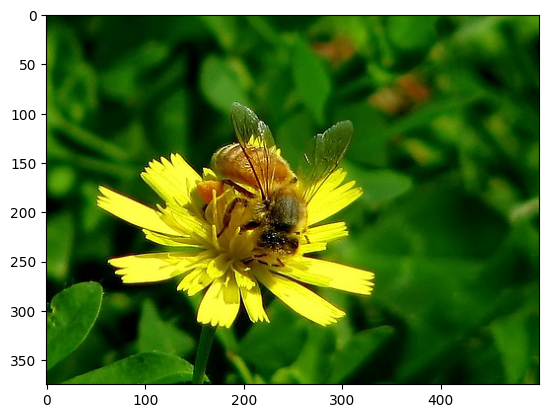

torch.Size([1, 3, 224, 224])


In [ ]:
img = cv.imread("/content/hymenoptera_data/val/bees/1297972485_33266a18d9.jpg")
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
plt.imshow(img)
plt.show()

transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomResizedCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
img = np.array(img)
img = transform(img)
img = img.unsqueeze(0)
print(img.size())

In [ ]:
# 모델 내부 컨볼루션 레이어의 출력 feature map 추출
no_of_layers = 0
conv_layers = []

model_children = list(modelVGG.children())

for child in model_children:
    if type(child)==nn.Conv2d:
        no_of_layers += 1
        conv_layers.append(child)
    elif type(child)==nn.Sequential: # Sequential의 하위 레이어 누락 방지
        for layer in child.children():
            if type(layer)==nn.Conv2d:
                no_of_layers += 1
                conv_layers.append(layer)

In [ ]:
# conv_layers에 저장된 레이어를 통과한 출력 이미지
conv_layers[0](img.to(device))

tensor([[[[-6.4273e-01, -8.9240e-02, -6.2760e-02,  ..., -4.1093e-01,
           -4.1151e-01,  1.6174e-01],
          [-7.5907e-01,  2.9627e-01,  3.5427e-01,  ..., -1.5375e-01,
           -1.1995e-01,  5.8302e-01],
          [-7.2866e-01,  2.9591e-01,  3.3828e-01,  ..., -1.6954e-01,
           -1.4857e-01,  6.9254e-01],
          ...,
          [-7.9855e-01,  3.6093e-02,  7.6739e-02,  ...,  1.5786e-01,
            1.6047e-01,  9.9144e-01],
          [-8.1330e-01,  9.3785e-02,  7.4600e-02,  ...,  1.1093e-01,
            1.4590e-01,  9.9989e-01],
          [-7.7889e-01,  1.1120e-01,  2.7916e-01,  ..., -3.6112e-02,
           -9.8367e-03,  5.4008e-01]],

         [[-2.6490e+00,  2.4261e-01,  5.6180e-02,  ..., -4.0860e-01,
           -4.0291e-01,  1.8181e+00],
          [-2.2787e+00,  8.1257e-01,  6.2562e-01,  ...,  3.2767e-01,
            2.6820e-01,  2.7290e+00],
          [-2.1867e+00,  8.5553e-01,  6.5182e-01,  ...,  3.2406e-01,
            3.2957e-01,  2.8760e+00],
          ...,
     

In [ ]:
results = [conv_layers[0](img.to(device))]
for i in range(1, len(conv_layers)):
    results.append(conv_layers[i](results[-1])) # 직전 출력을 입력으로 사용
outputs = results

In [ ]:
outputs[0].shape
# outputs 원소의 형태 [데이터 개수(batch), channel, height, width]

torch.Size([1, 64, 224, 224])

Layer 1


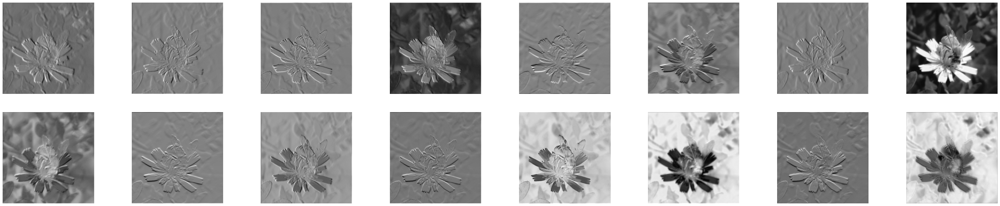

Layer 2


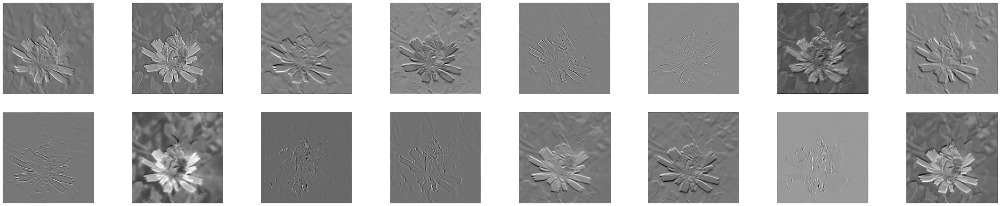

Layer 3


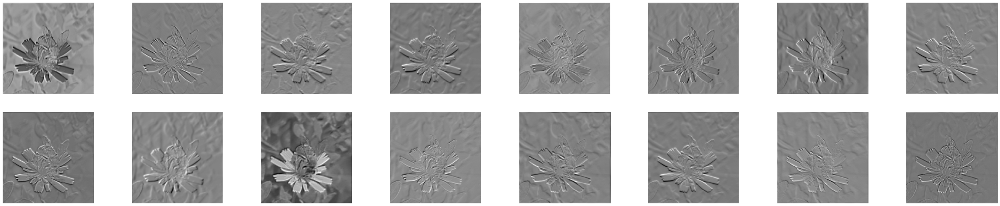

Layer 4


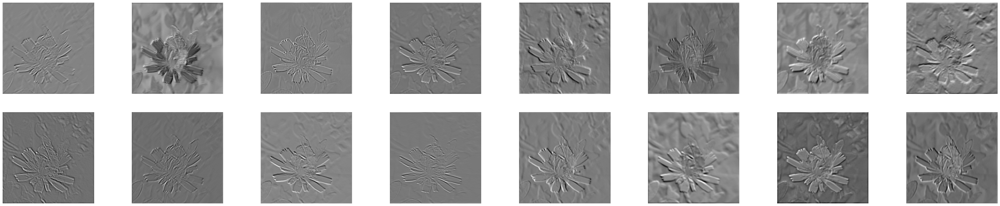

Layer 5


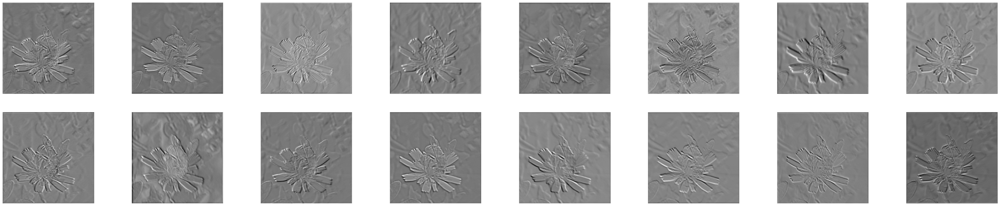

Layer 6


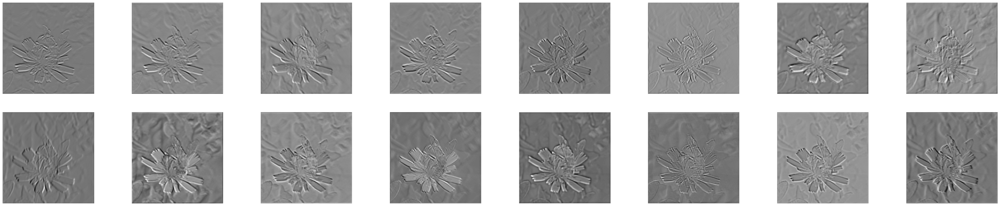

Layer 7


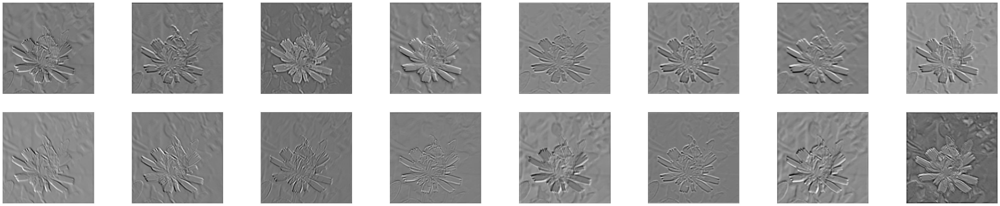

Layer 8


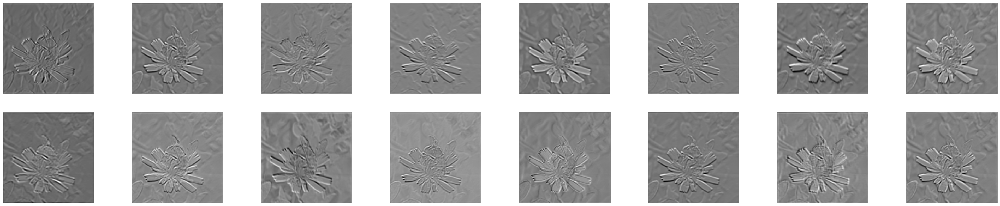

Layer 9


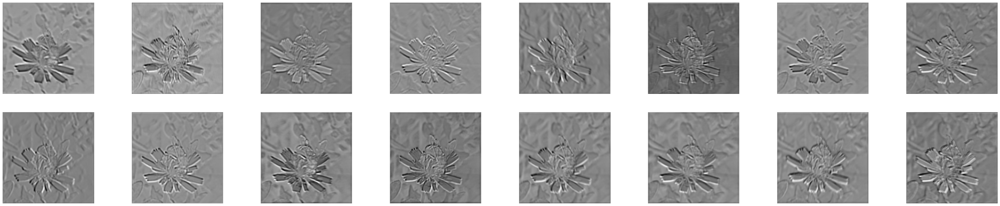

Layer 10


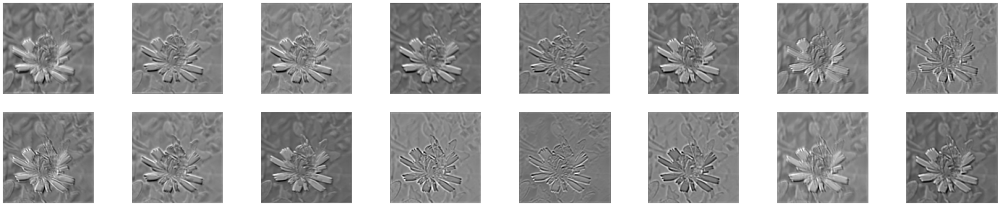

Layer 11


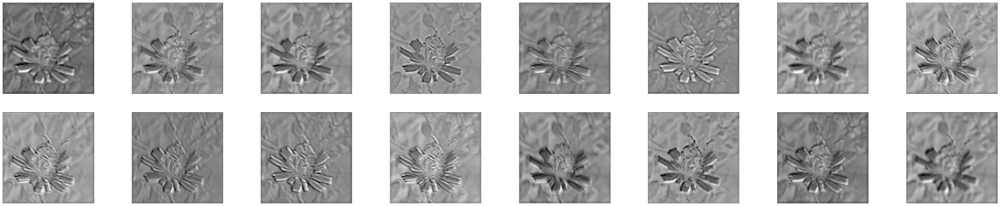

Layer 12


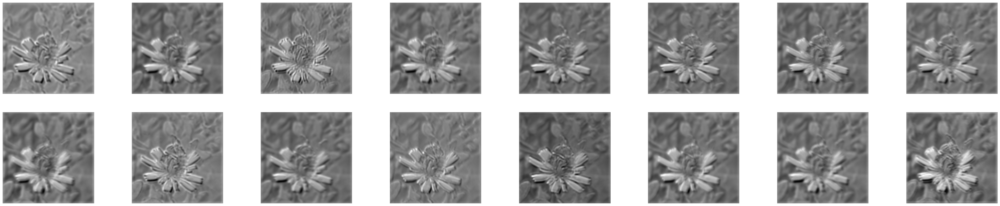

Layer 13


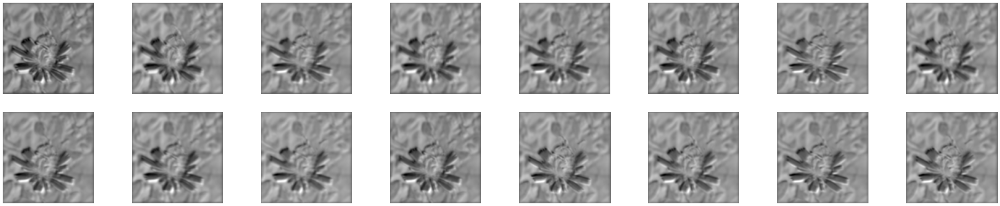

In [ ]:
# feature map 시각화
for num_layer in range(len(outputs)):
    plt.figure(figsize=(50, 10))
    layer_viz = outputs[num_layer][0, :, :, :].data.to(device)
    print("Layer", num_layer+1)
    # 현재 레이어에 대한 출력의 채널별 시각화 (더 많은 필터를 사용했더라도 16개 까지만)
    for i, filter in enumerate(layer_viz):
        if i==16:
            break
        plt.subplot(2, 8, i+1)
        plt.imshow(filter.cpu(), cmap='gray')
        plt.axis("off")
    plt.show()
    plt.close()

>뒤로 갈수록 필터별 출력(채널 값) 차이가 감소
- 초반에는 각 레이어 내의 서로 다른 필터들이 데이터의 다양하고 직관적인 특징을 잘 추출
- 후반에는 대동소이하거나 지엽적인 특징을 추출
 - 후반의 데이터는 충분히 고급 정보로 변환된 것으로 해석

## 다른 모델과 다른 데이터로 위 과정 수행
단, 필터별 출력(채널 값)을 구분하지 않고 레이어 단위로 출력
- 구분하지 않기 위해 채널 방향으로 합산 ; 실제 처리 방식은 어파인 변환에 의한 가중 합과 편향 추가

In [ ]:
!wget https://hips.hearstapps.com/hmg-prod/images/dog-puppy-on-garden-royalty-free-image-1586966191.jpg?crop=0.752xw:1.00xh;0.175xw,0&resize=1200:*

--2023-04-17 17:08:07--  https://hips.hearstapps.com/hmg-prod/images/dog-puppy-on-garden-royalty-free-image-1586966191.jpg?crop=0.752xw:1.00xh
Resolving hips.hearstapps.com (hips.hearstapps.com)... 151.101.0.155, 151.101.64.155, 151.101.128.155, ...
Connecting to hips.hearstapps.com (hips.hearstapps.com)|151.101.0.155|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 176823 (173K) [image/jpeg]
Saving to: ‘dog-puppy-on-garden-royalty-free-image-1586966191.jpg?crop=0.752xw:1.00xh.2’

dog-puppy-on-garden 100%[===================>] 172.68K  --.-KB/s    in 0.02s   

2023-04-17 17:08:08 (7.58 MB/s) - ‘dog-puppy-on-garden-royalty-free-image-1586966191.jpg?crop=0.752xw:1.00xh.2’ saved [176823/176823]

/bin/bash: 0.175xw,0: command not found


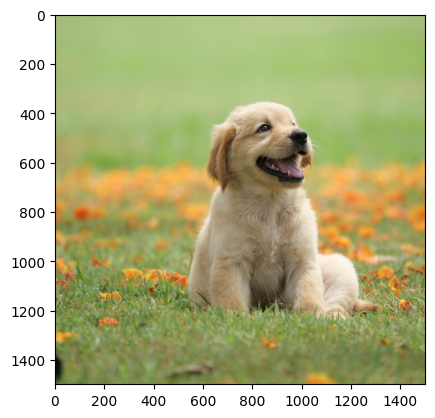

In [ ]:
image = Image.open(str('/content/dog-puppy-on-garden-royalty-free-image-1586966191.jpg?crop=0.752xw:1.00xh'))
plt.imshow(image)

Resizing : 크기 224*224로 사진 자르기
- `transforms.Resize([224,224])`

이미지 채널 정규화 mean=0, std=1
- `transforms.Normalize(0,1)`

In [ ]:
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize([224,224]),
    transforms.ToTensor(),
    transforms.Normalize(0,1)
    ])
image = np.array(image)
image = transform(image)
image = image.unsqueeze(0)
print(image.size())

torch.Size([1, 3, 224, 224])


In [ ]:
# pretrained resnet18 모델
model = models.resnet18(weights='DEFAULT').to(device)

In [ ]:
print(model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [ ]:
# 중간 feature map 저장
model_weights = []
conv_layers = []
model_children = list(model.children())
counter = 0
for i in range(len(model_children)):
    if type(model_children[i]) == nn.Conv2d:
        counter += 1
        model_weights.append(model_children[i].weight)
        conv_layers.append(model_children[i])
    elif type(model_children[i]) == nn.Sequential:
        for j in range(len(model_children[i])):
            # Sequential 하위에도 블럭 구조로 구성
            for child in model_children[i][j].children():
                if type(child) == nn.Conv2d:
                    counter += 1
                    model_weights.append(child.weight)
                    conv_layers.append(child)

outputs = []
names = []
for layer in conv_layers[0:]:
    image = layer(image.to(device))
    outputs.append(image)
    names.append(str(layer))

In [ ]:
len(outputs)

17

In [ ]:
torch.sum(outputs[0].squeeze(0), 0).shape

torch.Size([112, 112])

In [ ]:
processed = []
for feature_map in outputs:
    feature_map = feature_map.squeeze(0)
    gray_scale = torch.sum(feature_map,0) # 출력을 채널 방향으로 합
    gray_scale = gray_scale / feature_map.shape[0] # 평균
    processed.append(gray_scale.data.cpu().numpy())
    # 이전과 다르게 채널을 뭉쳐서 시각화

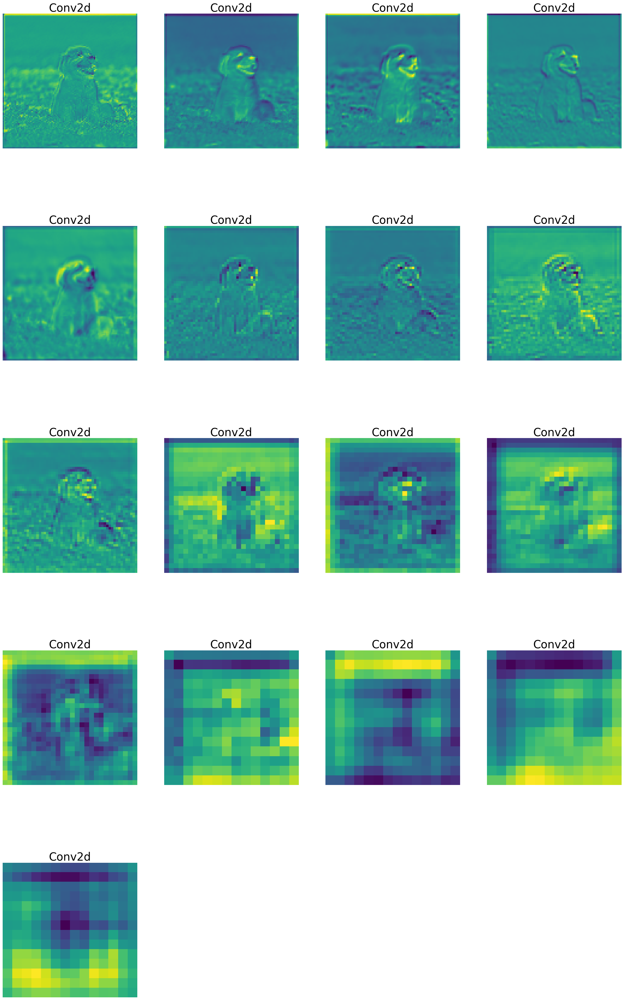

In [ ]:
fig = plt.figure(figsize=(30, 50))
for i in range(len(processed)):
    a = fig.add_subplot(5, 4, i+1)
    imgplot = plt.imshow(processed[i])
    a.axis("off")
    a.set_title(names[i].split('(')[0], fontsize=30)
plt.savefig(str('feature_maps.jpg'), bbox_inches='tight')

>레이어 단위로 비교해보면 후반 레이어의 출력은 데이터가 고급 정보의 형태로 추상화된 것으로 해석

# Model-Agnostic Explanation

**XAI** : explainable AI $\leftrightarrow$ Blackbox (random forest / gradient boosting / support vector machine / neural net)

Blackbox ?
- nonlinearity
- complicated ensemble
- no explanation for feature attribution & interaction

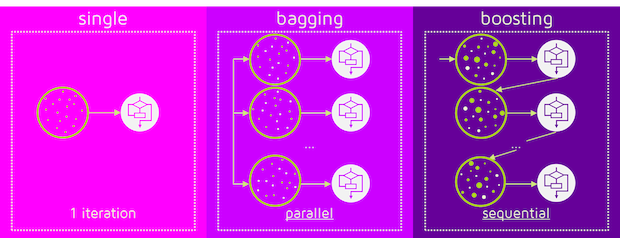

**Global Interpretability**
- 학습된 반응 함수에 의해 모형화 된 조건분포 전체를 이해
- 해석은 대략적이거나 평균값에 근거

**Local Interpretability**
- 단일 데이터 포인트나 분포의 작은 영역에 대한 이해
- 조건분포의 작은 영역은 선형일 가능성이 더 높음 $\rightarrow$ 정확도가 높은 편

**Feature Attribution**
- 모델의 결과 값에 대한 input의 기여도를 측정하는 척도
- 바람직한 성질 : Local Accuracy / Missingness / Consistency

※ post-hoc explainability : 사후분석을 통한 설명 가능

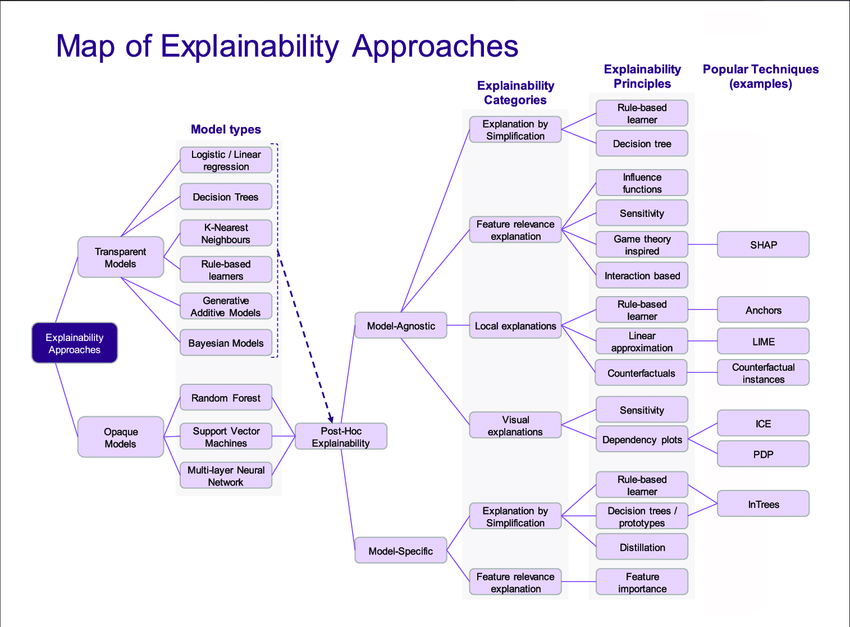

**Additive Feature Attribution Method**
- glassbox model $\rightarrow$ surrogate

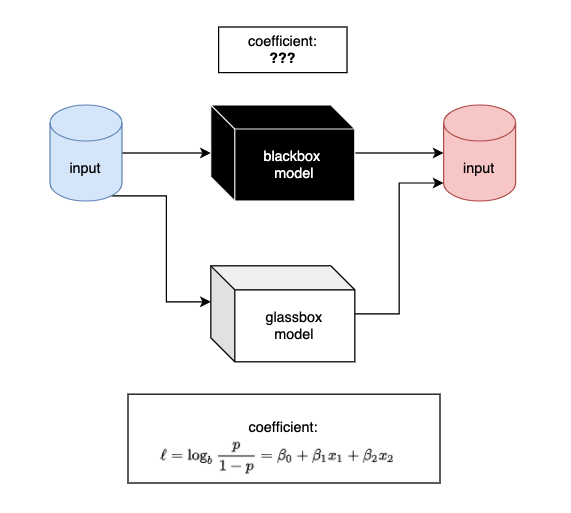

## [LIME](http://sameersingh.org/files/papers/lime-kdd16.pdf) (Local Interpretable Model-agnostic Explanations)
- Local Interpretability & Model-agnostic
- 모든 예측 모델에 대한 결과를 신뢰할 수 있는 방법으로 설명 ; 단순한 로컬 모델로 글로벌 모델에 비해 근사 용이
- 로컬 설명을 학습하기 위해 분류기(Classifier)의 결정 경계(Decision Boundary)를 <ins>해석 가능한 모델(glassbox model)을 이용해 근사
- tabular / text / image / …


1. 입력 값의 교란(Perturb)을 통해 예측의 변동 확인
2. 교란된 인스턴스에 대해 설명하고자 하는 인스턴스와의 유사성으로 가중치 부여
3. feature 선택을 위해 라소(Lasso) 모델 적합 및 선형 회귀 계수 학습

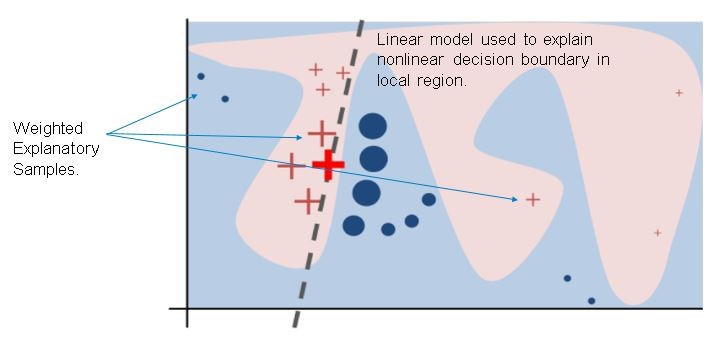

- 파란색 및 분홍색 배경 : 선형 모델이 제대로 근사하기 어려운 블랙 박스 모델의 복잡한 함수
- 굵은 십자가 : 설명되고 있는 인스턴스
- 나머지 원과 십자가 : 샘플링된 인스턴스 ; 설명되는 인스턴스와의 근접성에 따라 가중치를 크기로 표현
- 점선 : 로컬 영역에서 학습된 신뢰 가능한 설명

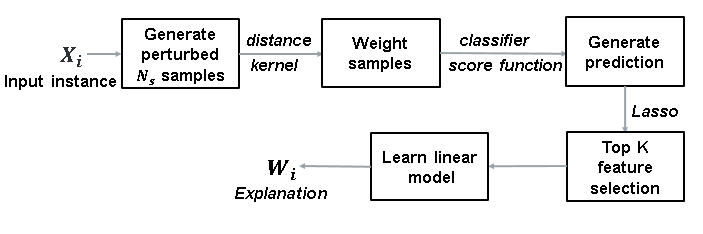

>EX.
- 교란된 인스턴스 세트 : 픽셀(feature) 일부를 회색으로 마스킹
- 교란된 각 인스턴스로부터 청개구리 여부 예측 : 블랙박스 모델을 통해 예측
- 블랙박스 모델의 예측을 기반으로 가중치가 부여된 라소 회귀 수행 및 K개 픽셀 선택
- 높은 가중치를 갖는 픽셀이 설명자(explainer)
- 사용되지 않는 픽셀이 마스킹 된 원본 이미지로 설명

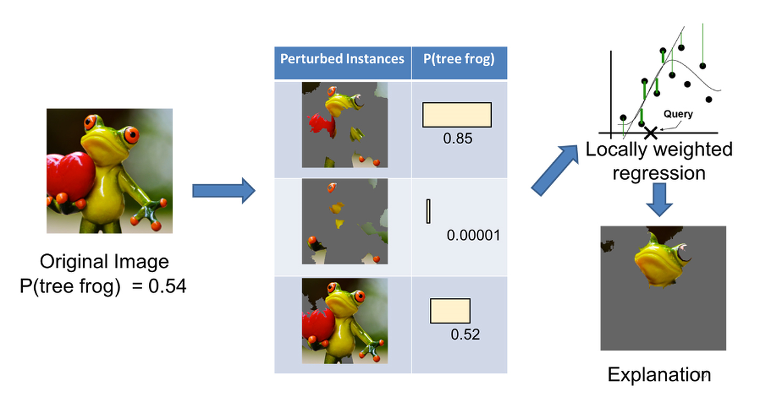

In [ ]:
!pip install lime

### LIME : wine 데이터 실습

In [ ]:
wine = pd.read_csv('wine.csv')
wine.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


`quality`를 5.5 기준으로 범주화하여 target(`y`)로 설정(binary classification) 후 데이터셋 분할

In [ ]:
wine['quality'] = wine['quality'].apply(lambda x: 1 if x>5.5 else 0)

In [ ]:
from sklearn.model_selection import train_test_split
X = wine.drop('quality', axis=1)
y = wine['quality']
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, stratify=y, random_state=42)

`RandomForest` 분류 모델 적합

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [ ]:
print(rf.score(X_train, y_train))
print(rf.score(X_test, y_test))

1.0
0.80625


**LIME** 적용

In [ ]:
import lime
from lime import lime_tabular # table 형식 데이터
explainer = lime_tabular.LimeTabularExplainer(
    training_data = X_train.values,
    feature_names = X_train.columns,
    class_names = ['-', '+'], # binary : 음성(0) | 양성(1) (quality)
    mode = 'classification'
)

>테스트 세트의 2번 샘플에 대한 예측 설명

In [ ]:
print('y_true :', y_test.iloc[2])
print('y_pred :', rf.predict(X_test.iloc[2:3]))

y_true : 0
y_pred : [0]


In [ ]:
# 로컬 인스턴스 설정
exp2 = explainer.explain_instance(
    data_row = X_test.iloc[2],
    predict_fn = rf.predict_proba # predict 아님 주의
)

exp2.show_in_notebook(show_table=True)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


- LEFT : <ins>prediction probabilities</ins> of negative and positive from classifier

- MID : <ins>feature contribution</ins> to probability ; region supporting class

- RIGHT : original data

>테스트 세트의 9번 샘플에 대한 예측 설명

In [ ]:
print('y_true :', y_test.iloc[9])
print('y_pred :', rf.predict(X_test.iloc[9:10]))

y_true : 1
y_pred : [1]


In [ ]:
exp9 = explainer.explain_instance(
    data_row = X_test.iloc[9],
    predict_fn = rf.predict_proba
)

exp9.show_in_notebook(show_table=True)
# 이전 설명 예시와 클래스 지지 영역 비교

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


## [SHAP](https://proceedings.neurips.cc/paper_files/paper/2017/file/8a20a8621978632d76c43dfd28b67767-Paper.pdf) (SHapley Additive exPlanations)
- 모델 설명을 위한 게임 이론 기반 접근 방식
- **Shapley Value** 이용
- 각 특성 기여도 및 특성 간 상호작용에 대한 로컬 및 글로벌 설명 가능
- `permutation feature importance` 방식 보완
- 시각화 용이

>특성 $i$ 에 대한 Shapley Value 계산 공식
- <ins>marginal contribution</ins>의 평균 형태
- $x'$ : 고차원 데이터의 경우 요약치
- $M$ : 전체 특성 개수 ; 차원 수
- 특성의 부분 입력은 랜덤 값 부여를 통해 구현
- 계산의 조합적 폭발 $\rightarrow$ 다양한 [SHAP 알고리즘](https://github.com/slundberg/shap)
 - KernelSHAP : Model-Agnostic / Relatively Slow / Approximate calculation
 - TreeSHAP : Tree-based Model / Fast / Exact calculation
 - DeepSHAP, GradientSHAP : Deep Learning Model

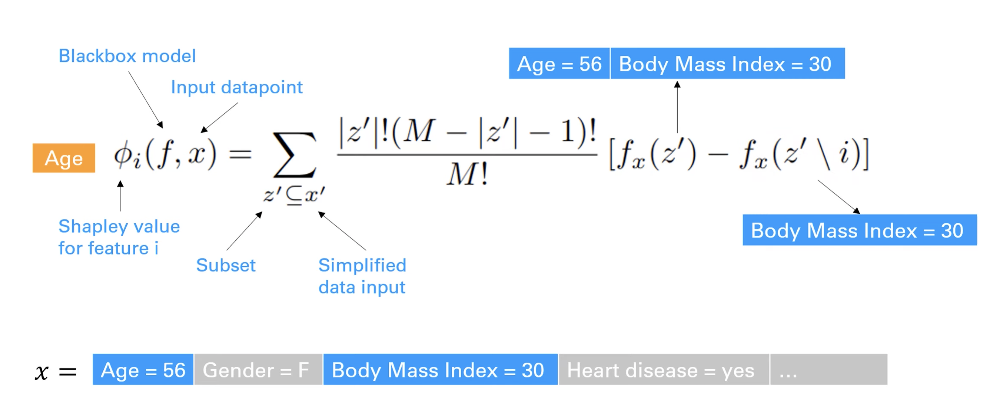

✔︎ SHAP는 model-agnostic explanation model의 feature attribution method에 요구되는 바람직한 성질을 모두 이론적으로 만족

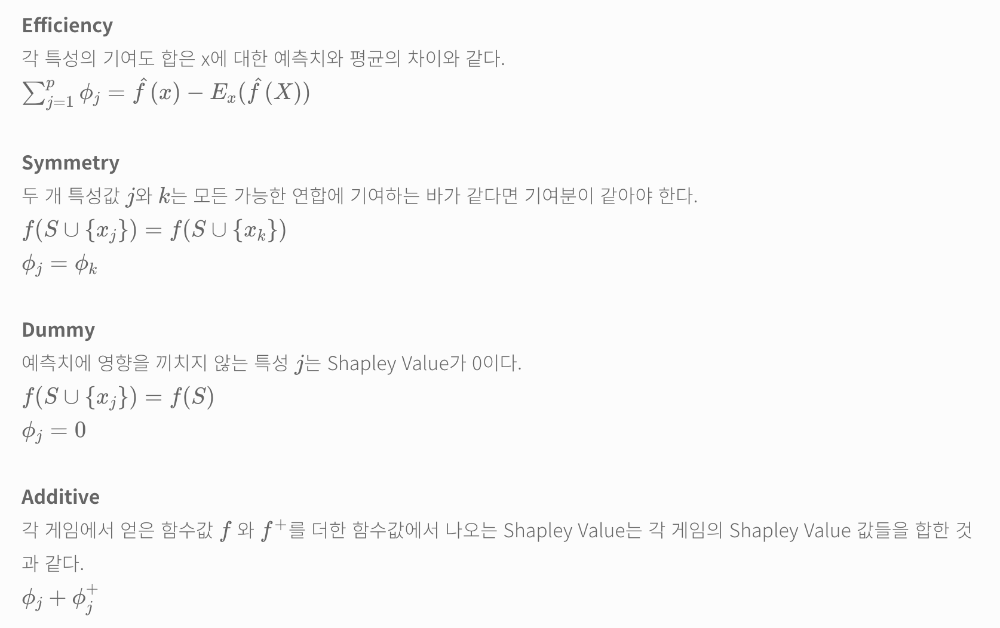

In [ ]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.6/572.6 kB 15.5 MB/s eta 0:00:00


### SHAP : wine 데이터 실습

`XGB` 분류 모델 적합

In [ ]:
from xgboost import XGBClassifier, plot_importance
xgb = XGBClassifier()
xgb.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [ ]:
y_test.iloc[0]

1

In [ ]:
xgb.predict(X_test)[0]

0

In [ ]:
xgb.predict_proba(X_test)[0]

array([0.8065809 , 0.19341908], dtype=float32)

**SHAP** 적용

- 각 feature 내 Shapley Value 분포 시각화 (Local)

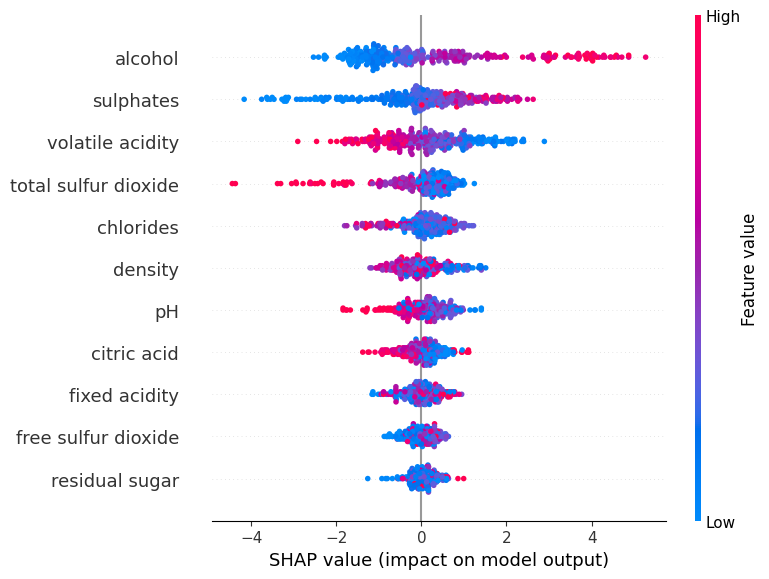

In [ ]:
import shap
shap.initjs()
explainer = shap.TreeExplainer(xgb)
shap_values = explainer.shap_values(X_test, approximate=False, check_additivity=False)
shap.summary_plot(shap_values, X_test)

- 각 feature의 Shapley Value 절댓값의 평균 : 모델 출력에 미치는 영향의 크기 (Global)

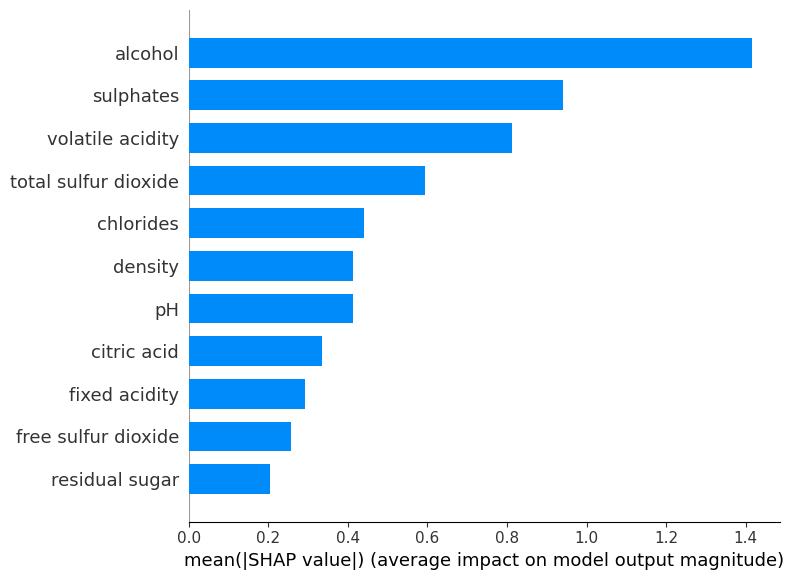

In [ ]:
shap.summary_plot(shap_values, X_test, plot_type='bar')

- interaction effect (Shapley Interaction Value)

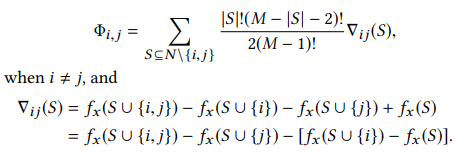

- main effect

$\large \qquad\qquad\Phi_{i,i}=\phi_i-\sum_{j≠i}\Phi_{i,j}$

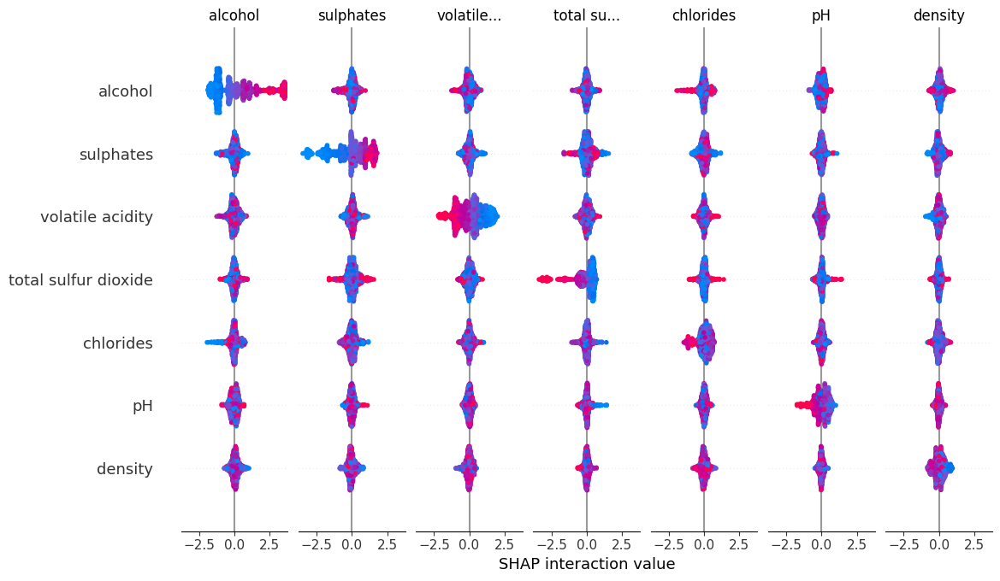

In [ ]:
shap_interaction_values = explainer.shap_interaction_values(X_train)
shap.summary_plot(shap_interaction_values, X_train)

### DeepSHAP : MNIST 데이터 실습

- high-speed approximation algorithm for SHAP in deep learning model
- based on [DeepLIFT](https://arxiv.org/pdf/1704.02685.pdf)
- using background distribution of sub samples, not single reference value
- Shapley equation : linearize component $\rightarrow$ computation

In [ ]:
import torch, torchvision
from torchvision import datasets, transforms
from torch import nn, optim
from torch.nn import functional as F
import numpy as np
import shap
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

batch_size = 128
num_epochs = 15

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        self.conv_layers = nn.Sequential(
            nn.Conv2d(in_channels=1, out_channels=10, kernel_size=5),
            nn.MaxPool2d(kernel_size=2),
            nn.ReLU(),
            nn.Conv2d(10, 20, kernel_size=5),
            nn.Dropout(),
            nn.MaxPool2d(2),
            nn.ReLU()
        )
        self.fc_layers = nn.Sequential(
            nn.Linear(320, 50),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(50, 10),
            nn.Softmax(dim=1)
        )

    def forward(self, x):
        x = self.conv_layers(x)
        x = x.view(-1, 320)
        x = self.fc_layers(x)
        return x

def train(model, device, train_loader, optimizer, epoch):
    model.train()
    for batch_idx, (data, target) in enumerate(train_loader):
        data, target = data.to(device), target.to(device)
        optimizer.zero_grad()
        output = model(data)
        loss = F.nll_loss(output.log(), target)
        loss.backward()
        optimizer.step()
        if batch_idx%100==0:
            print(f'Train Epoch: {epoch} [{batch_idx*len(data)}/{len(train_loader.dataset)} ({100.*batch_idx/len(train_loader):.0f}%)]\tLoss: {loss.item():.6f}')

def test(model, device, test_loader):
    model.eval()
    test_loss = 0.0
    correct = 0.0
    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            test_loss += F.nll_loss(output.log(), target).item()
            pred = output.max(1, keepdim=True)[1]
            correct += pred.eq(target.view_as(pred)).sum().item()
    test_loss /= len(test_loader.dataset)
    print(f'\nTest set: Average loss: {test_loss:.4f}, Accuracy: {correct}/{len(test_loader.dataset)} ({100.*correct/len(test_loader.dataset):.0f}%)\n')

In [ ]:
train_loader = torch.utils.data.DataLoader(
    datasets.MNIST('mnist_data', train=True, download=True, transform=transforms.ToTensor()), batch_size=batch_size, shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    datasets.MNIST('mnist_data', train=False, download=True, transform=transforms.ToTensor()), batch_size=batch_size, shuffle=True
)
model = Net().to(device)
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.5)

for epoch in range(1, num_epochs+1):
    train(model, device, train_loader, optimizer, epoch)
    test(model, device, test_loader)

Train Epoch: 1 [0/60000 (0%)]	Loss: 2.313685
Train Epoch: 1 [12800/60000 (21%)]	Loss: 2.149870
Train Epoch: 1 [25600/60000 (43%)]	Loss: 1.394211
Train Epoch: 1 [38400/60000 (64%)]	Loss: 0.824451
Train Epoch: 1 [51200/60000 (85%)]	Loss: 0.664644

Test set: Average loss: 0.0046, Accuracy: 8959.0/10000 (90%)

Train Epoch: 2 [0/60000 (0%)]	Loss: 0.769444
Train Epoch: 2 [12800/60000 (21%)]	Loss: 0.792894
Train Epoch: 2 [25600/60000 (43%)]	Loss: 0.636550
Train Epoch: 2 [38400/60000 (64%)]	Loss: 0.409753
Train Epoch: 2 [51200/60000 (85%)]	Loss: 0.488427

Test set: Average loss: 0.0026, Accuracy: 9321.0/10000 (93%)

Train Epoch: 3 [0/60000 (0%)]	Loss: 0.741688
Train Epoch: 3 [12800/60000 (21%)]	Loss: 0.508627
Train Epoch: 3 [25600/60000 (43%)]	Loss: 0.626918
Train Epoch: 3 [38400/60000 (64%)]	Loss: 0.352129
Train Epoch: 3 [51200/60000 (85%)]	Loss: 0.360233

Test set: Average loss: 0.0019, Accuracy: 9484.0/10000 (95%)

Train Epoch: 4 [0/60000 (0%)]	Loss: 0.380011
Train Epoch: 4 [12800/60000 (21

In [ ]:
batch = next(iter(test_loader))
images, _ = batch
# background samples
background = images[:120].to(device)
test_images = images[120:]
# DeepExplainer로 구현
e = shap.DeepExplainer(model, background)
shap_values = e.shap_values(test_images)

<ins>*shap value per class*
- Red pixel : + / Blue pixel : -
- sum of shap values = difference between background-expected output and model output of current input sample

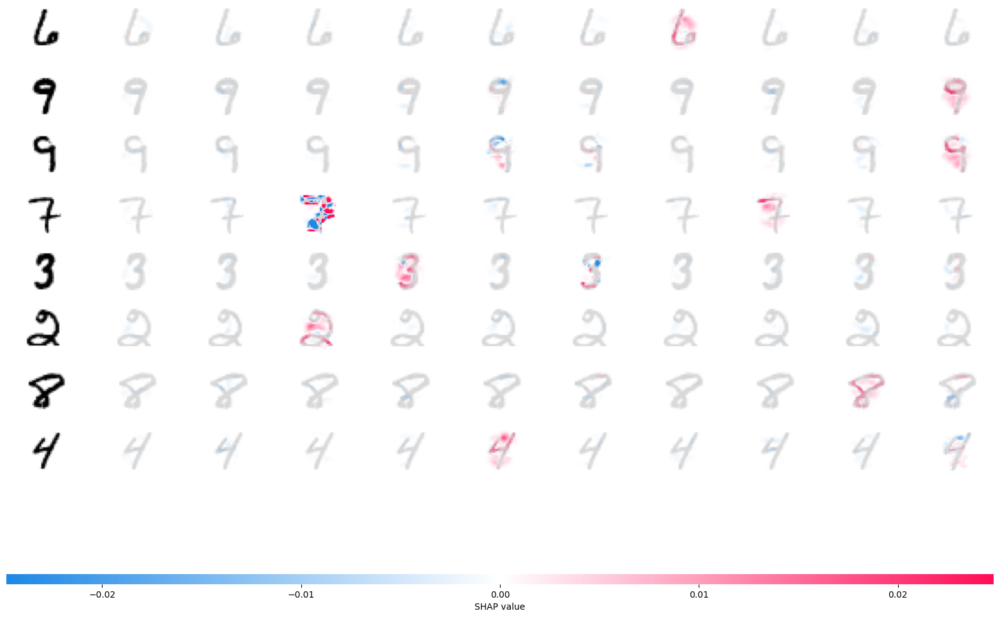

In [ ]:
# feature attribution
shap_numpy = [np.swapaxes(np.swapaxes(s, 1, -1), 1, 2) for s in shap_values]
test_numpy = np.swapaxes(np.swapaxes(test_images.numpy(), 1, -1), 1, 2)
shap.image_plot(shap_numpy, -test_numpy)

### GradientSHAP : ImageNet 데이터 실습

- based on [Integrated Gradients](https://arxiv.org/pdf/1703.01365.pdf)
- using background distribution of entire dataset
- slower but more reliable approximation than DeepSHAP
- combined expectation of gradient $\rightarrow$ attribution
- layer-explainable ; shap value for each feature map
- local smoothing $\rightarrow$ capturing correlated regions of image

In [ ]:
import torch, torchvision
from torch import nn
from torchvision import transforms, models, datasets
import shap
import json
import numpy as np
# ImageNet ; randomly collected
url = "https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json"
fname = shap.datasets.cache(url)
with open(fname) as f:
    class_names = json.load(f)
X,y = shap.datasets.imagenet50()
X /= 255
to_explain = X[[39, 41]] # 설명할 샘플

# 전처리 함수 정의
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]
def normalize(image):
    if image.max() > 1:
        image /= 255
    image = (image - mean) / std
    return torch.tensor(image.swapaxes(-1, 1).swapaxes(2, 3)).float()

# pretrained VGG
model = models.vgg16(weights='DEFAULT').eval()
X = normalize(X)
ex = normalize(to_explain)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 274MB/s]


In [ ]:
print(class_names)
X.shape, y.shape

{'0': ['n01440764', 'tench'], '1': ['n01443537', 'goldfish'], '2': ['n01484850', 'great_white_shark'], '3': ['n01491361', 'tiger_shark'], '4': ['n01494475', 'hammerhead'], '5': ['n01496331', 'electric_ray'], '6': ['n01498041', 'stingray'], '7': ['n01514668', 'cock'], '8': ['n01514859', 'hen'], '9': ['n01518878', 'ostrich'], '10': ['n01530575', 'brambling'], '11': ['n01531178', 'goldfinch'], '12': ['n01532829', 'house_finch'], '13': ['n01534433', 'junco'], '14': ['n01537544', 'indigo_bunting'], '15': ['n01558993', 'robin'], '16': ['n01560419', 'bulbul'], '17': ['n01580077', 'jay'], '18': ['n01582220', 'magpie'], '19': ['n01592084', 'chickadee'], '20': ['n01601694', 'water_ouzel'], '21': ['n01608432', 'kite'], '22': ['n01614925', 'bald_eagle'], '23': ['n01616318', 'vulture'], '24': ['n01622779', 'great_grey_owl'], '25': ['n01629819', 'European_fire_salamander'], '26': ['n01630670', 'common_newt'], '27': ['n01631663', 'eft'], '28': ['n01632458', 'spotted_salamander'], '29': ['n01632777', 

(torch.Size([50, 3, 224, 224]), (50,))

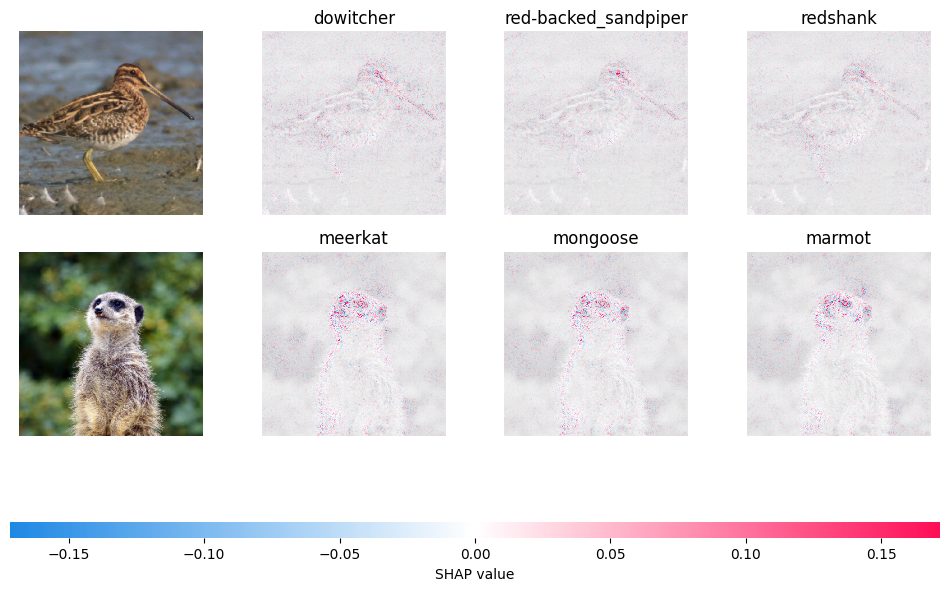

In [ ]:
# GradientExplainer로 구현 ; 레이어, 클래스 단위 계산 가능

# original
e = shap.GradientExplainer(model, X)
shap_values, indexes = e.shap_values(ex, ranked_outputs=3, nsamples=75)
# class names
index_names = np.vectorize(lambda x: class_names[str(x)][1])(indexes)
# feature attribution
shap_values = [np.transpose(s, (0,2,3,1)) for s in shap_values]
shap.image_plot(shap_values, to_explain, index_names)

In [ ]:
# conv layer 해석
cvs = []
for i in range(len(model.features)):
    if type(model.features[i])==torch.nn.modules.conv.Conv2d:
        cvs.append(model.features[i])
len(cvs) # 0, 3, 6, 9, 12만 예시 확인

13

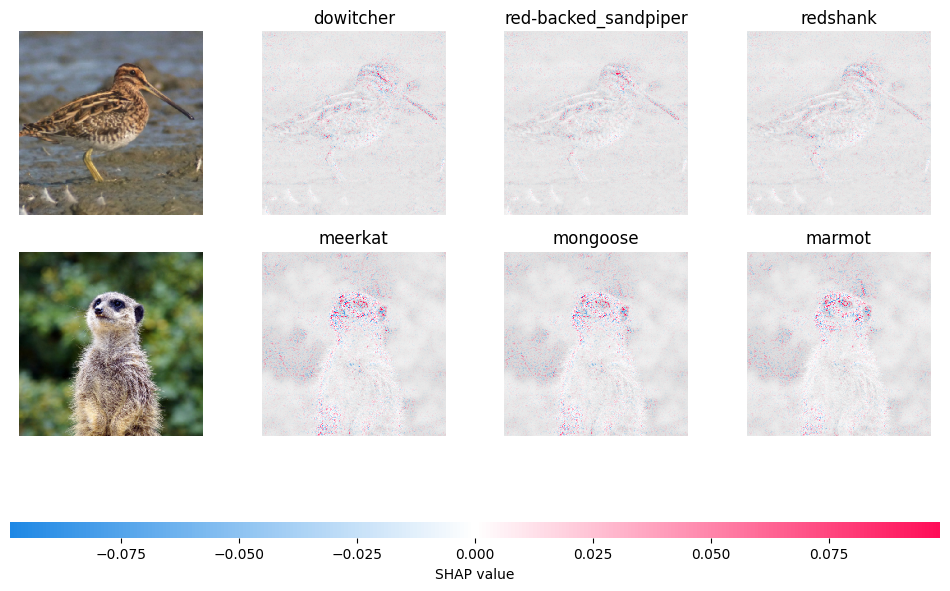

In [ ]:
# cvs[0]
e = shap.GradientExplainer((model, cvs[0]), X)
shap_values, indexes = e.shap_values(ex, ranked_outputs=3, nsamples=75)
index_names = np.vectorize(lambda x: class_names[str(x)][1])(indexes)
# feature attribution
shap_values = [np.transpose(s, (0,2,3,1)) for s in shap_values]
shap.image_plot(shap_values, to_explain, index_names)

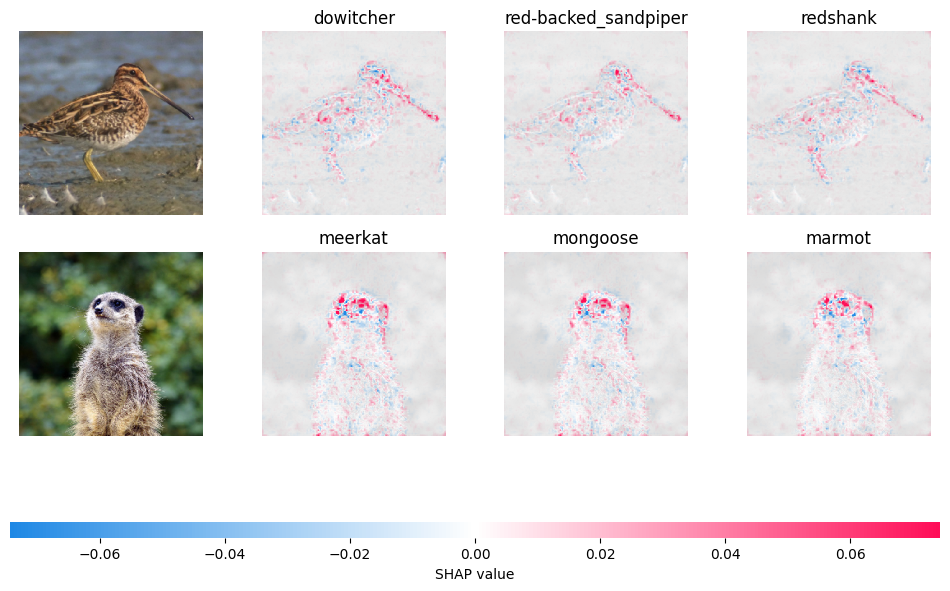

In [ ]:
# cvs[3]
e = shap.GradientExplainer((model, cvs[3]), X)
shap_values, indexes = e.shap_values(ex, ranked_outputs=3, nsamples=75)
index_names = np.vectorize(lambda x: class_names[str(x)][1])(indexes)
# feature attribution
shap_values = [np.transpose(s, (0,2,3,1)) for s in shap_values]
shap.image_plot(shap_values, to_explain, index_names)

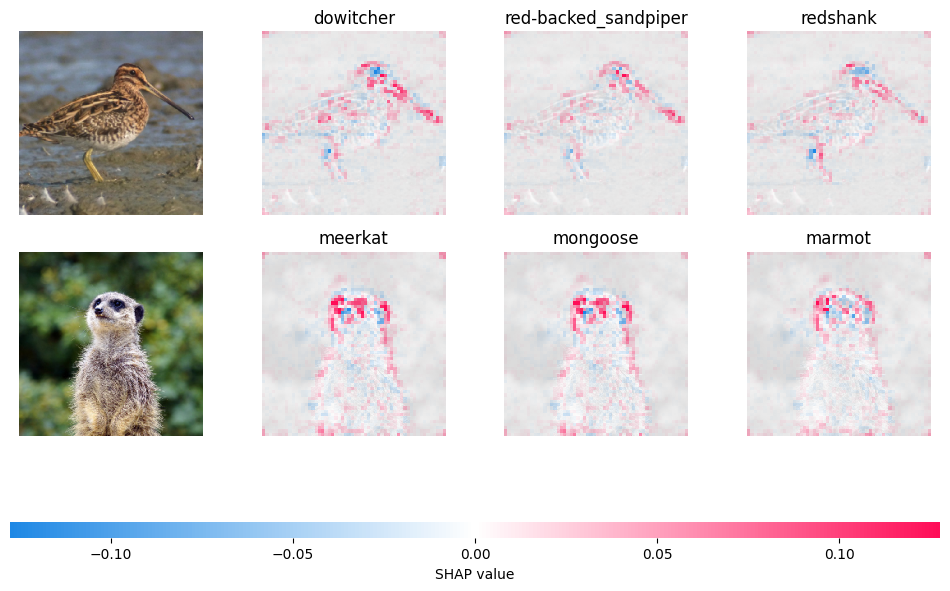

In [ ]:
# cvs[6]
e = shap.GradientExplainer((model, cvs[6]), X)
shap_values, indexes = e.shap_values(ex, ranked_outputs=3, nsamples=75)
index_names = np.vectorize(lambda x: class_names[str(x)][1])(indexes)
# feature attribution
shap_values = [np.transpose(s, (0,2,3,1)) for s in shap_values]
shap.image_plot(shap_values, to_explain, index_names)

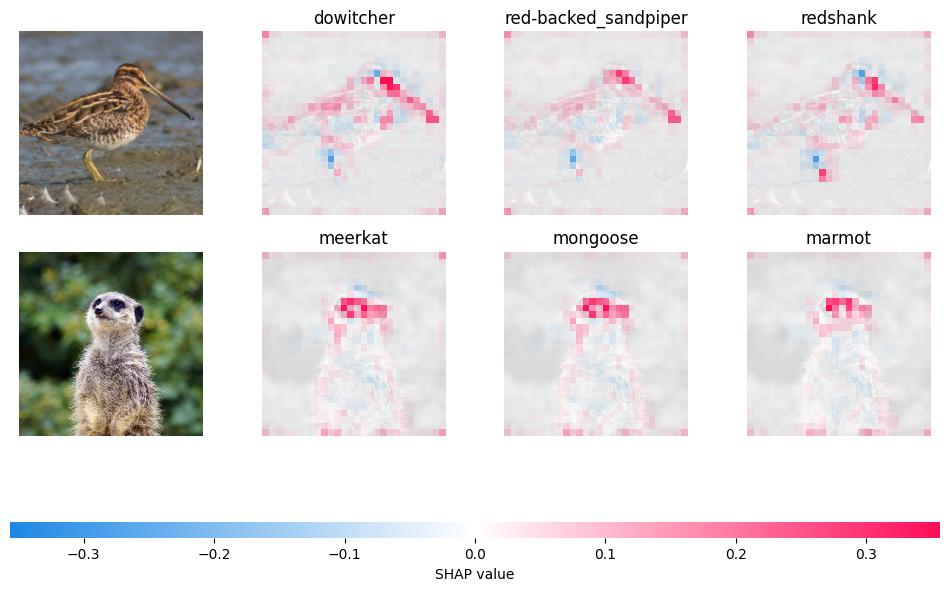

In [ ]:
# cvs[9]
e = shap.GradientExplainer((model, cvs[9]), X)
shap_values, indexes = e.shap_values(ex, ranked_outputs=3, nsamples=75)
index_names = np.vectorize(lambda x: class_names[str(x)][1])(indexes)
# feature attribution
shap_values = [np.transpose(s, (0,2,3,1)) for s in shap_values]
shap.image_plot(shap_values, to_explain, index_names)

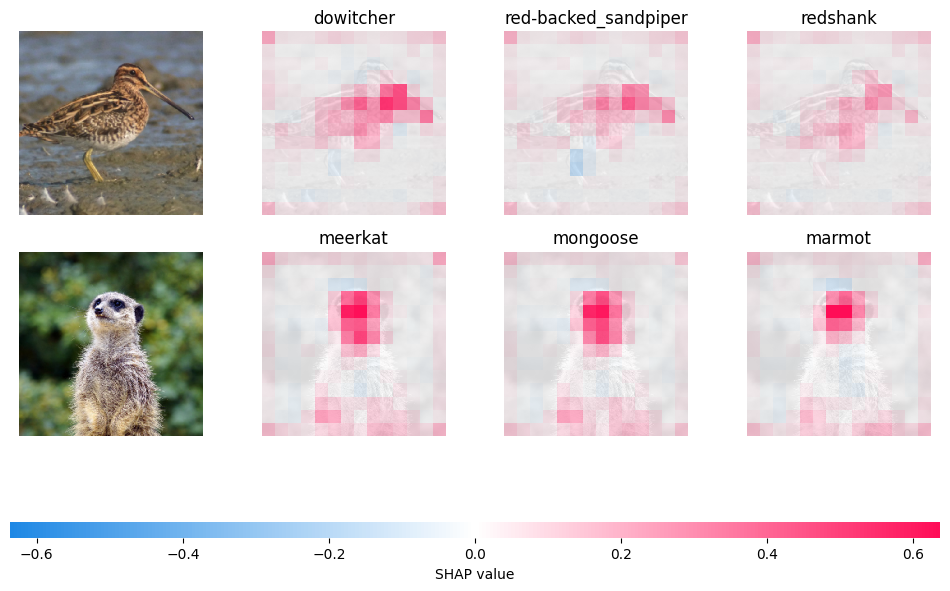

In [ ]:
# cvs[12]
e = shap.GradientExplainer((model, cvs[12]), X)
shap_values, indexes = e.shap_values(ex, ranked_outputs=3, nsamples=75)
index_names = np.vectorize(lambda x: class_names[str(x)][1])(indexes)
# feature attribution
shap_values = [np.transpose(s, (0,2,3,1)) for s in shap_values]
shap.image_plot(shap_values, to_explain, index_names)